In [64]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from PIL import Image

import torch
from transformers import VisionEncoderDecoderModel, ViTFeatureExtractor, AutoTokenizer

from sklearn.metrics import accuracy_score

In [2]:
import nltk
import ssl

try:
    _create_unverified_https_context = ssl._create_unverified_context
except AttributeError:
    pass
else:
    ssl._create_default_https_context = _create_unverified_https_context

nltk.download()

showing info https://raw.githubusercontent.com/nltk/nltk_data/gh-pages/index.xml


: 

: 

In [2]:
from nltk.corpus import wordnet as wn
from nltk.tokenize import word_tokenize, sent_tokenize
from nltk.wsd import lesk
for ss in wn.synsets('bang'):
    print(ss, ss.definition())

Synset('knock.n.03') a vigorous blow
Synset('bang.n.02') a sudden very loud noise
Synset('bang.n.03') a border of hair that is cut short and hangs across the forehead
Synset('bang.n.04') the swift release of a store of affective force
Synset('hit.n.03') a conspicuous success
Synset('slam.v.02') strike violently
Synset('bang.v.02') to produce a sharp often metallic explosive or percussive sound
Synset('slam.v.01') close violently
Synset('bang.v.04') move noisily
Synset('sleep_together.v.01') have sexual intercourse with
Synset('spang.v.01') leap, jerk, bang
Synset('bang.r.01') directly


In [176]:
for ss in wn.synsets('troll'):
    print(ss, ss.definition())

Synset('troll.n.01') (Scandanavian folklore) a supernatural creature (either a dwarf or a giant) that is supposed to live in caves or in the mountains
Synset('round.n.11') a partsong in which voices follow each other; one voice starts and others join in one after another until all are singing different parts of the song at the same time
Synset('troll.n.03') a fisherman's lure that is used in trolling
Synset('troll.n.04') angling by drawing a baited line through the water
Synset('troll.v.01') circulate, move around
Synset('troll.v.02') cause to move round and round
Synset('troll.v.03') sing the parts of (a round) in succession
Synset('troll.v.04') angle with a hook and line drawn through the water
Synset('troll.v.05') sing loudly and without inhibition
Synset('troll.v.06') praise or celebrate in song
Synset('troll.v.07') speak or recite rapidly or in a rolling voice


In [14]:
PATH = "/Users/carlosito/Documents/vsCode/vs-DANI/DL-Project/semeval-2023-task-1-V-WSD-train-v1/train_v1/"
data = pd.read_csv(PATH+'train.data.v1.txt', delimiter='\t', header=None)
data.head()

,0,1,2,3,4,5,6,7,8,9,10,11
0,moorhen,moorhen swamphen,image.3.jpg,image.8.jpg,image.4.jpg,image.1.jpg,image.2.jpg,image.0.jpg,image.5.jpg,image.6.jpg,image.7.jpg,image.9.jpg
1,serinus,serinus genus,image.3.jpg,image.23.jpg,image.4.jpg,image.1.jpg,image.2.jpg,image.20.jpg,image.5.jpg,image.24.jpg,image.22.jpg,image.21.jpg
2,pegmatite,pegmatite igneous,image.41.jpg,image.39.jpg,image.42.jpg,image.43.jpg,image.40.jpg,image.44.jpg,image.37.jpg,image.38.jpg,image.36.jpg,image.35.jpg
3,bangalores,bangalores torpedo,image.58.jpg,image.59.jpg,image.64.jpg,image.57.jpg,image.55.jpg,image.56.jpg,image.62.jpg,image.63.jpg,image.61.jpg,image.60.jpg
4,bonxie,bonxie skua,image.3.jpg,image.77.jpg,image.78.jpg,image.4.jpg,image.1.jpg,image.2.jpg,image.5.jpg,image.79.jpg,image.76.jpg,image.75.jpg


In [16]:
keys = pd.read_csv(PATH+'train.gold.v1.txt', delimiter='\t', header=None)
keys.head()

,0
0,image.0.jpg
1,image.20.jpg
2,image.35.jpg
3,image.55.jpg
4,image.75.jpg


In [17]:
df = pd.concat([data, keys],axis=1)
df.columns = ['keyword', 'context', 'img1', 'img2', 'img3', 'img4', 'img5', 'img6', 'img7', 'img8', 'img9', 'img10', 'gold_key']
df.head()

,keyword,context,img1,img2,img3,img4,img5,img6,img7,img8,img9,img10,gold_key
0,moorhen,moorhen swamphen,image.3.jpg,image.8.jpg,image.4.jpg,image.1.jpg,image.2.jpg,image.0.jpg,image.5.jpg,image.6.jpg,image.7.jpg,image.9.jpg,image.0.jpg
1,serinus,serinus genus,image.3.jpg,image.23.jpg,image.4.jpg,image.1.jpg,image.2.jpg,image.20.jpg,image.5.jpg,image.24.jpg,image.22.jpg,image.21.jpg,image.20.jpg
2,pegmatite,pegmatite igneous,image.41.jpg,image.39.jpg,image.42.jpg,image.43.jpg,image.40.jpg,image.44.jpg,image.37.jpg,image.38.jpg,image.36.jpg,image.35.jpg,image.35.jpg
3,bangalores,bangalores torpedo,image.58.jpg,image.59.jpg,image.64.jpg,image.57.jpg,image.55.jpg,image.56.jpg,image.62.jpg,image.63.jpg,image.61.jpg,image.60.jpg,image.55.jpg
4,bonxie,bonxie skua,image.3.jpg,image.77.jpg,image.78.jpg,image.4.jpg,image.1.jpg,image.2.jpg,image.5.jpg,image.79.jpg,image.76.jpg,image.75.jpg,image.75.jpg


In [18]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [19]:
device

device(type='cpu')

In [20]:
df[df['keyword'] == 'troll']

,keyword,context,img1,img2,img3,img4,img5,img6,img7,img8,img9,img10,gold_key
1881,troll,troll creature,image.12269.jpg,image.1690.jpg,image.6634.jpg,image.5202.jpg,image.895.jpg,image.788.jpg,image.894.jpg,image.897.jpg,image.898.jpg,image.5233.jpg,image.12269.jpg
1900,troll,troll angling,image.964.jpg,image.2138.jpg,image.12854.jpg,image.11362.jpg,image.966.jpg,image.10539.jpg,image.901.jpg,image.967.jpg,image.965.jpg,image.1685.jpg,image.12854.jpg


In [24]:
TROLL_MON_IMAGE_PATH = "/Users/carlosito/Documents/vsCode/vs-DANI/DL-Project/semeval-2023-task-1-V-WSD-train-v1/train_v1/train_images_v1/image.12269.jpg"
TROLL_FISH_IMAGE_PATH = "/Users/carlosito/Documents/vsCode/vs-DANI/DL-Project/semeval-2023-task-1-V-WSD-train-v1/train_v1/train_images_v1/image.12854.jpg"

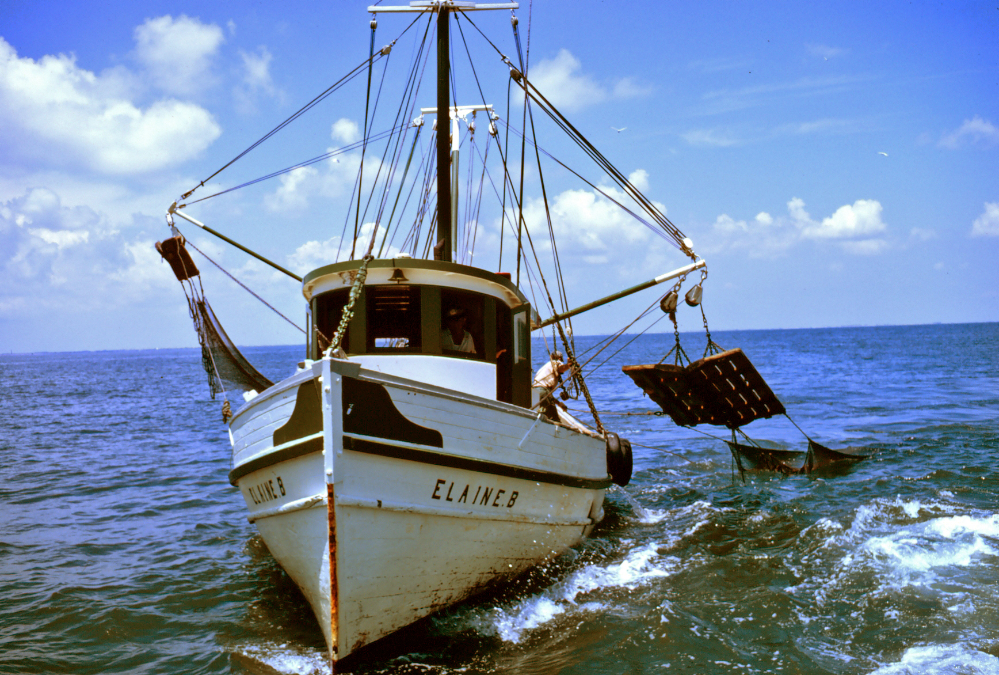

In [22]:
Image.open(TROLL_FISH_IMAGE_PATH)

In [11]:
model = VisionEncoderDecoderModel.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
feature_extractor = ViTFeatureExtractor.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
tokenizer = AutoTokenizer.from_pretrained("nlpconnect/vit-gpt2-image-captioning")

In [12]:
max_length = 16
num_beams = 4
gen_kwargs = {"max_length": max_length, "num_beams": num_beams}

In [25]:
pixel_values = feature_extractor(images=Image.open(TROLL_MON_IMAGE_PATH), return_tensors="pt").pixel_values
pixel_values = pixel_values.to(device)
gen_kwargs = {"max_length": max_length, "num_beams": num_beams}
output_ids = model.generate(pixel_values, **gen_kwargs)
pred_1 = tokenizer.batch_decode(output_ids, skip_special_tokens=True)
print(pred_1)

['a painting of a group of people in a fire place ']


In [27]:
pixel_values = feature_extractor(images=Image.open(TROLL_FISH_IMAGE_PATH), return_tensors="pt").pixel_values
pixel_values = pixel_values.to(device)
gen_kwargs = {"max_length": max_length, "num_beams": num_beams}
output_ids = model.generate(pixel_values, **gen_kwargs)
pred_2 = tokenizer.batch_decode(output_ids, skip_special_tokens=True)
print(pred_2)

['a small boat in the water with another boat in the distance ']


In [5]:
sense1 = lesk(word_tokenize("troll creature"),'troll')
print(sense1, sense1.definition())

sense2 = lesk(word_tokenize("troll angling"),'troll')
print(sense2, sense2.definition())

Synset('troll.n.01') (Scandanavian folklore) a supernatural creature (either a dwarf or a giant) that is supposed to live in caves or in the mountains
Synset('troll.n.04') angling by drawing a baited line through the water


In [28]:
from nltk.translate.bleu_score import sentence_bleu

In [32]:
sentence_bleu(pred_1, sense1.definition() )

0.09896355857934787

In [34]:
sentence_bleu(pred_2, sense2.definition() )

0.2652126455101337

In [42]:
from rouge import Rouge
rouge = Rouge()

In [43]:
rouge.get_scores(pred_1,  sense1.definition() )

AssertionError: 

In [45]:
rouge.get_scores('I am crazy',  'its britney bitch, crazy sdfsdfsdfsdf,ds,fsdfsdf ' )

[{'rouge-1': {'r': 0.2, 'p': 0.3333333333333333, 'f': 0.24999999531250006},
  'rouge-2': {'r': 0.0, 'p': 0.0, 'f': 0.0},
  'rouge-l': {'r': 0.2, 'p': 0.3333333333333333, 'f': 0.24999999531250006}}]

In [51]:
rouge.get_scores(sense1.definition(),  pred_1[0] )

[{'rouge-1': {'r': 0.25, 'p': 0.1111111111111111, 'f': 0.15384614958579892},
  'rouge-2': {'r': 0.0, 'p': 0.0, 'f': 0.0},
  'rouge-l': {'r': 0.125, 'p': 0.05555555555555555, 'f': 0.07692307266272212}}]

In [52]:
rouge.get_scores(sense2.definition(),  pred_2[0] )

[{'rouge-1': {'r': 0.3333333333333333,
   'p': 0.3333333333333333,
   'f': 0.3333333283333334},
  'rouge-2': {'r': 0.1111111111111111, 'p': 0.125, 'f': 0.11764705384083066},
  'rouge-l': {'r': 0.3333333333333333,
   'p': 0.3333333333333333,
   'f': 0.3333333283333334}}]

In [ ]:
model = VisionEncoderDecoderModel.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
feature_extractor = ViTFeatureExtractor.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
tokenizer = AutoTokenizer.from_pretrained("nlpconnect/vit-gpt2-image-captioning")


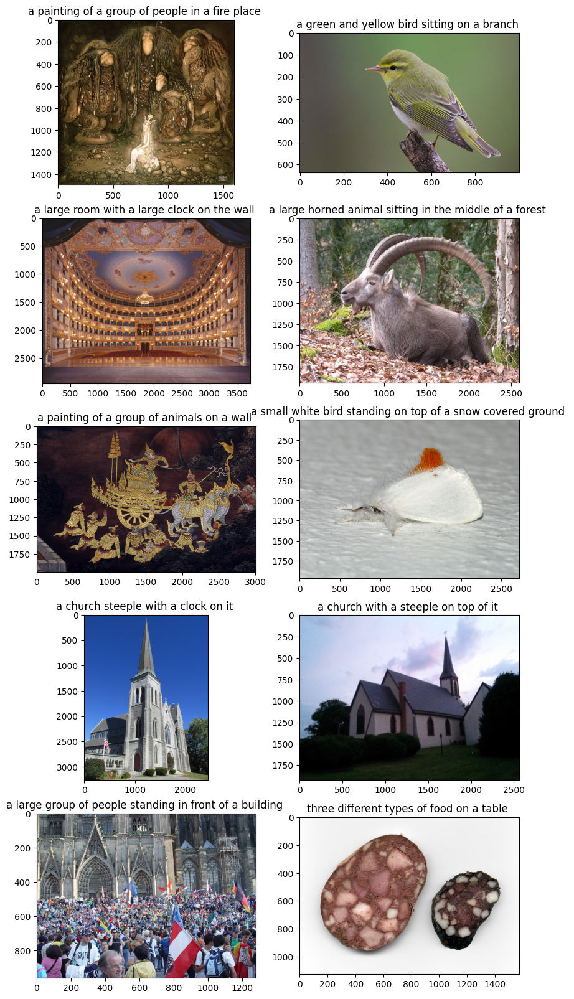

In [87]:
test_data = df.iloc[1881]
generated_text_list = []


fig, axes = plt.subplots(nrows = 5, ncols = 2, figsize = (10,20))

for img in range(1,11):
    selected_col = test_data[f'img{img}']
    IMAGE_PATH = "/Users/carlosito/Documents/vsCode/vs-DANI/DL-Project/semeval-2023-task-1-V-WSD-train-v1/train_v1/train_images_v1/"
    IMAGE_PATH_EACH = IMAGE_PATH + selected_col
    
    plot_img = Image.open(IMAGE_PATH_EACH)
    axes.flatten()[img-1].imshow(plot_img)
    
    
    pixel_values = feature_extractor(images= plot_img, return_tensors="pt").pixel_values
    pixel_values = pixel_values.to(device)
    gen_kwargs = {"max_length": max_length, "num_beams": num_beams}
    output_ids = model.generate(pixel_values, **gen_kwargs)
    pred = tokenizer.batch_decode(output_ids, skip_special_tokens=True)
    axes.flatten()[img-1].title.set_text(pred[0])

    generated_text_list.extend(pred)

In [89]:
test_data

keyword               troll
context      troll creature
img1        image.12269.jpg
img2         image.1690.jpg
img3         image.6634.jpg
img4         image.5202.jpg
img5          image.895.jpg
img6          image.788.jpg
img7          image.894.jpg
img8          image.897.jpg
img9          image.898.jpg
img10        image.5233.jpg
gold_key    image.12269.jpg
Name: 1881, dtype: object

In [108]:
word_description = lesk(word_tokenize(test_data['context']), test_data['keyword']).definition()
print(word_description)

(Scandanavian folklore) a supernatural creature (either a dwarf or a giant) that is supposed to live in caves or in the mountains


In [109]:
for i in range(10):
    print(rouge.get_scores(word_description, generated_text_list[i] )[0]['rouge-1']['f'])

0.15384614958579892
0.07692307266272212
0.15384614958579892
0.21428570969387764
0.07999999596800021
0.06896551253269949
0.07999999596800021
0.07692307266272212
0.14814814370370383
0.07692307266272212


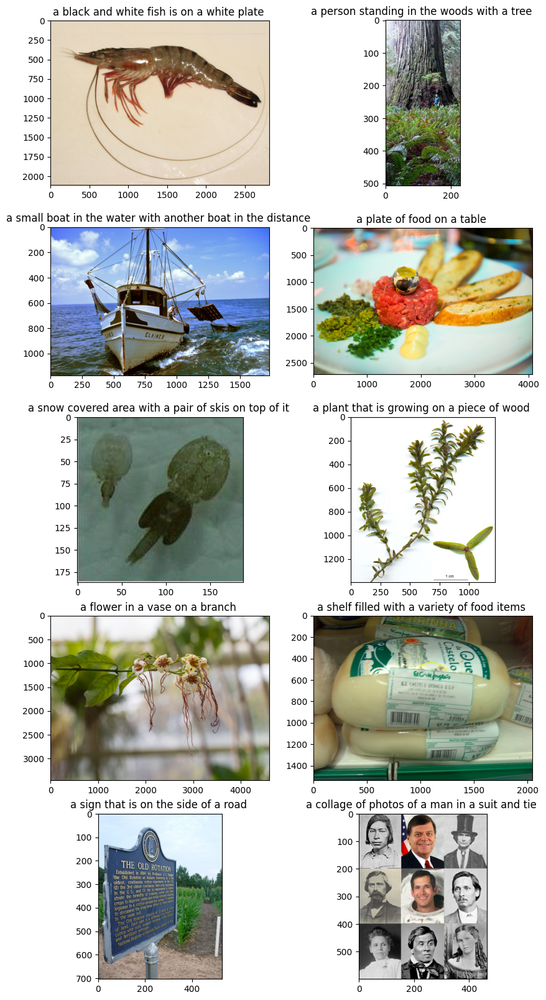

In [110]:
test_data = df.iloc[1900]
generated_text_list = []


fig, axes = plt.subplots(nrows = 5, ncols = 2, figsize = (10,20))

for img in range(1,11):
    selected_col = test_data[f'img{img}']
    IMAGE_PATH = "/Users/carlosito/Documents/vsCode/vs-DANI/DL-Project/semeval-2023-task-1-V-WSD-train-v1/train_v1/train_images_v1/"
    IMAGE_PATH_EACH = IMAGE_PATH + selected_col
    
    plot_img = Image.open(IMAGE_PATH_EACH)
    axes.flatten()[img-1].imshow(plot_img)
    
    
    pixel_values = feature_extractor(images= plot_img, return_tensors="pt").pixel_values
    pixel_values = pixel_values.to(device)
    gen_kwargs = {"max_length": max_length, "num_beams": num_beams}
    output_ids = model.generate(pixel_values, **gen_kwargs)
    pred = tokenizer.batch_decode(output_ids, skip_special_tokens=True)
    axes.flatten()[img-1].title.set_text(pred[0])

    generated_text_list.extend(pred)

In [113]:
word_description = lesk(word_tokenize(test_data['context']), test_data['keyword']).definition()
print(word_description)
rouge_score_list = []
for i in range(10):
    rouge_score = rouge.get_scores(word_description, generated_text_list[i] )[0]['rouge-1']['f']
    print(rouge_score)
    rouge_score_list.append(rouge_score)

angling by drawing a baited line through the water
0.11764705384083066
0.23529411266435996
0.3333333283333334
0.1333333285333335
0.09999999505000023
0.11111110611111134
0.1333333285333335
0.11764705384083066
0.22222221722222232
0.11111110611111134


In [119]:
predicted_image_idx = np.argmax(rouge_score_list)
print(predicted_image_idx)

print(test_data[f'img{predicted_image_idx+1}'])

2
image.12854.jpg


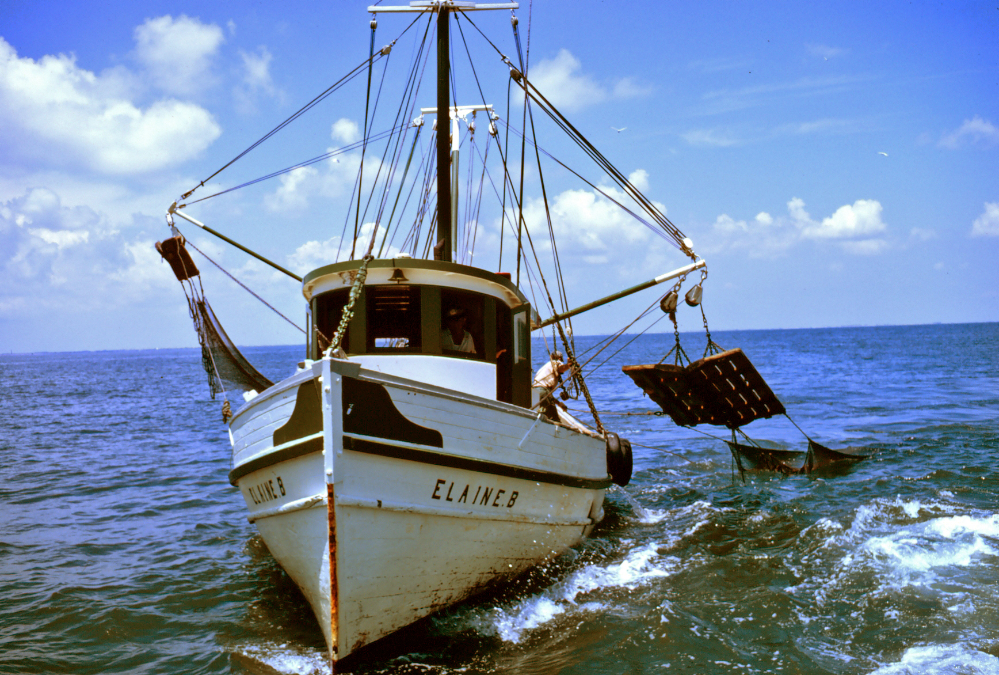

In [120]:
Image.open("/Users/carlosito/Documents/vsCode/vs-DANI/DL-Project/semeval-2023-task-1-V-WSD-train-v1/train_v1/train_images_v1/image.12854.jpg")

In [111]:
generated_text_list

['a black and white fish is on a white plate ',
 'a person standing in the woods with a tree ',
 'a small boat in the water with another boat in the distance ',
 'a plate of food on a table ',
 'a snow covered area with a pair of skis on top of it ',
 'a plant that is growing on a piece of wood ',
 'a flower in a vase on a branch ',
 'a shelf filled with a variety of food items ',
 'a sign that is on the side of a road ',
 'a collage of photos of a man in a suit and tie ']

In [74]:
test_data

keyword               troll
context      troll creature
img1        image.12269.jpg
img2         image.1690.jpg
img3         image.6634.jpg
img4         image.5202.jpg
img5          image.895.jpg
img6          image.788.jpg
img7          image.894.jpg
img8          image.897.jpg
img9          image.898.jpg
img10        image.5233.jpg
gold_key    image.12269.jpg
Name: 1881, dtype: object

---

## In case of not finding the LESK from keyword, then use context

In [122]:
df[df['keyword'] == 'heparnavirus']

,keyword,context,img1,img2,img3,img4,img5,img6,img7,img8,img9,img10,gold_key
6799,heparnavirus,heparnavirus hepatitis,image.418.jpg,image.14756.jpg,image.5424.jpg,image.786.jpg,image.5412.jpg,image.6577.jpg,image.2315.jpg,image.10769.jpg,image.2922.jpg,image.12609.jpg,image.5424.jpg


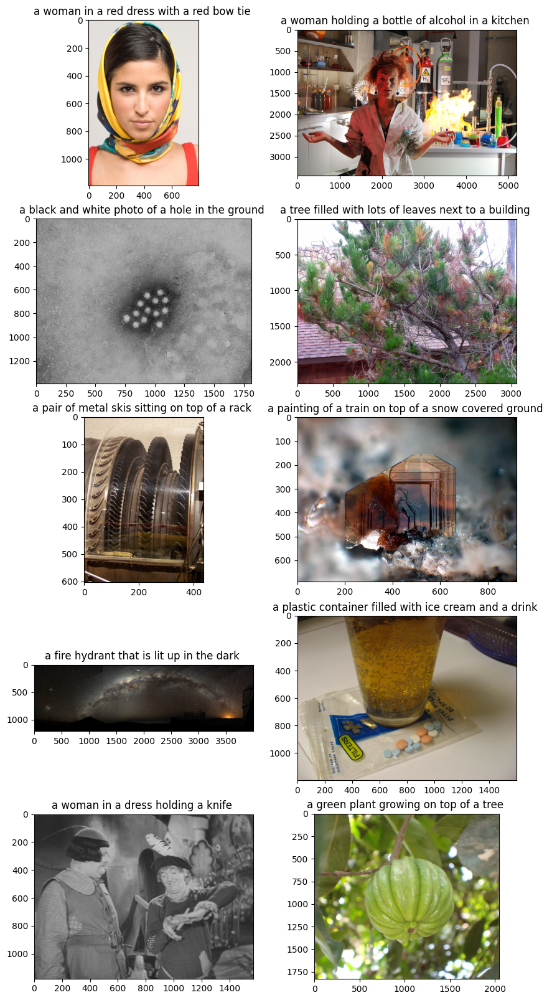

In [123]:
test_data = df.iloc[6799]
generated_text_list = []


fig, axes = plt.subplots(nrows = 5, ncols = 2, figsize = (10,20))

for img in range(1,11):
    selected_col = test_data[f'img{img}']
    IMAGE_PATH = "/Users/carlosito/Documents/vsCode/vs-DANI/DL-Project/semeval-2023-task-1-V-WSD-train-v1/train_v1/train_images_v1/"
    IMAGE_PATH_EACH = IMAGE_PATH + selected_col
    
    plot_img = Image.open(IMAGE_PATH_EACH)
    axes.flatten()[img-1].imshow(plot_img)
    
    
    pixel_values = feature_extractor(images= plot_img, return_tensors="pt").pixel_values
    pixel_values = pixel_values.to(device)
    gen_kwargs = {"max_length": max_length, "num_beams": num_beams}
    output_ids = model.generate(pixel_values, **gen_kwargs)
    pred = tokenizer.batch_decode(output_ids, skip_special_tokens=True)
    axes.flatten()[img-1].title.set_text(pred[0])

    generated_text_list.extend(pred)

In [128]:
test_data

keyword               heparnavirus
context     heparnavirus hepatitis
img1                 image.418.jpg
img2               image.14756.jpg
img3                image.5424.jpg
img4                 image.786.jpg
img5                image.5412.jpg
img6                image.6577.jpg
img7                image.2315.jpg
img8               image.10769.jpg
img9                image.2922.jpg
img10              image.12609.jpg
gold_key            image.5424.jpg
Name: 6799, dtype: object

In [137]:
lesk(word_tokenize('heparnavirus hepatitis'), 'hepatitis').definition()

'inflammation of the liver caused by a virus or a toxin'

In [138]:
word_description = lesk(word_tokenize('heparnavirus hepatitis'), 'hepatitis').definition()
print(word_description)
rouge_score_list = []
for i in range(10):
    rouge_score = rouge.get_scores(word_description, generated_text_list[i] )[0]['rouge-1']['f']
    print(rouge_score)
    rouge_score_list.append(rouge_score)

inflammation of the liver caused by a virus or a toxin
0.11111110617283973
0.22222221728395072
0.2999999950000001
0.19999999500000015
0.21052631080332423
0.21052631080332423
0.19999999500000015
0.1052631529085875
0.12499999531250018
0.22222221728395072


2
image.5424.jpg


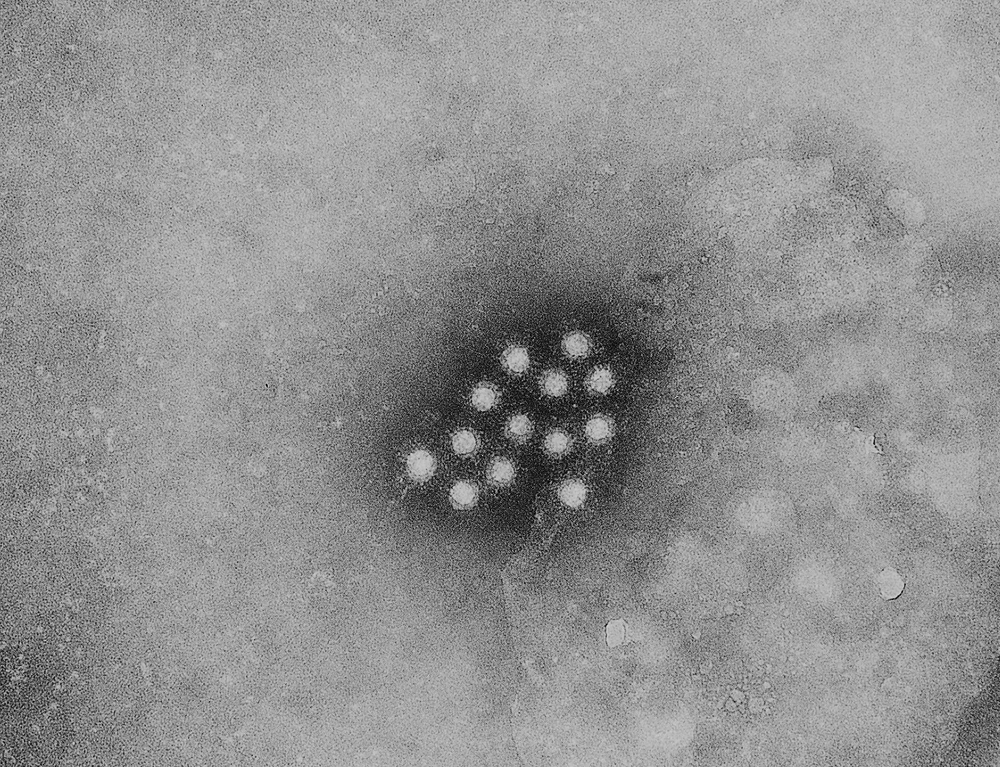

In [140]:
predicted_image_idx = np.argmax(rouge_score_list)
print(predicted_image_idx)

print(test_data[f'img{predicted_image_idx+1}'])
Image.open("/Users/carlosito/Documents/vsCode/vs-DANI/DL-Project/semeval-2023-task-1-V-WSD-train-v1/train_v1/train_images_v1/image.5424.jpg")

---

## Wrong classification of the dataset

In [144]:
df[df['keyword'] == 'pegmatite']

,keyword,context,img1,img2,img3,img4,img5,img6,img7,img8,img9,img10,gold_key
2,pegmatite,pegmatite igneous,image.41.jpg,image.39.jpg,image.42.jpg,image.43.jpg,image.40.jpg,image.44.jpg,image.37.jpg,image.38.jpg,image.36.jpg,image.35.jpg,image.35.jpg


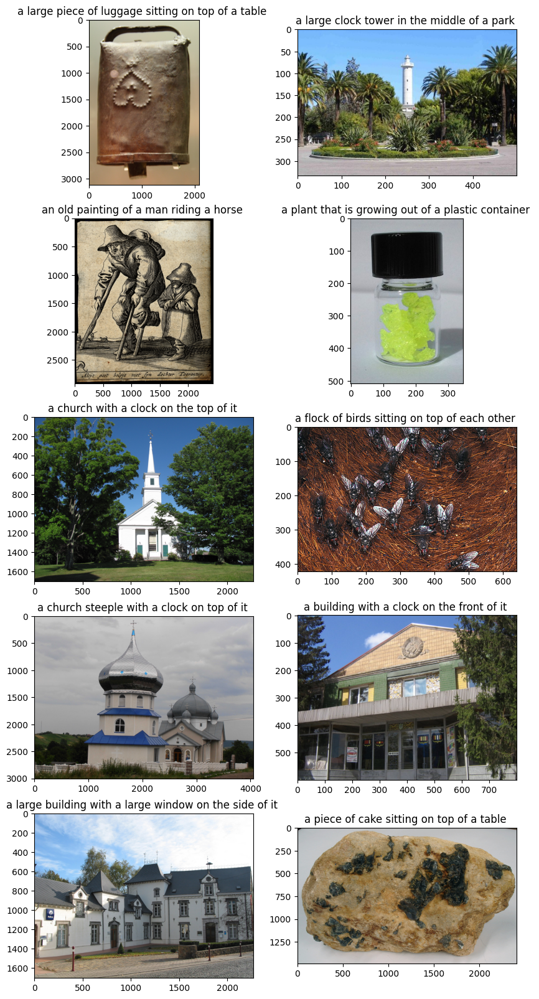

In [145]:
test_data = df.iloc[2]
generated_text_list = []


fig, axes = plt.subplots(nrows = 5, ncols = 2, figsize = (10,20))

for img in range(1,11):
    selected_col = test_data[f'img{img}']
    IMAGE_PATH = "/Users/carlosito/Documents/vsCode/vs-DANI/DL-Project/semeval-2023-task-1-V-WSD-train-v1/train_v1/train_images_v1/"
    IMAGE_PATH_EACH = IMAGE_PATH + selected_col
    
    plot_img = Image.open(IMAGE_PATH_EACH)
    axes.flatten()[img-1].imshow(plot_img)
    
    
    pixel_values = feature_extractor(images= plot_img, return_tensors="pt").pixel_values
    pixel_values = pixel_values.to(device)
    gen_kwargs = {"max_length": max_length, "num_beams": num_beams}
    output_ids = model.generate(pixel_values, **gen_kwargs)
    pred = tokenizer.batch_decode(output_ids, skip_special_tokens=True)
    axes.flatten()[img-1].title.set_text(pred[0])

    generated_text_list.extend(pred)

In [151]:
test_data

keyword             pegmatite
context     pegmatite igneous
img1             image.41.jpg
img2             image.39.jpg
img3             image.42.jpg
img4             image.43.jpg
img5             image.40.jpg
img6             image.44.jpg
img7             image.37.jpg
img8             image.38.jpg
img9             image.36.jpg
img10            image.35.jpg
gold_key         image.35.jpg
Name: 2, dtype: object

In [157]:
word_description = lesk(word_tokenize(test_data['context']), test_data['keyword']).definition()
print(word_description)
rouge_score_list = []
for i in range(10):
    rouge_score = rouge.get_scores(word_description, generated_text_list[i] )[0]['rouge-1']['f']
    print(rouge_score)
    rouge_score_list.append(rouge_score)
    
print()
predicted_image_idx = np.argmax(rouge_score_list)
print(predicted_image_idx)

print(f"predicted img: {test_data[f'img{predicted_image_idx+1}']}")
print(f"true img: {test_data.gold_key}")

a form of igneous rock consisting of extremely coarse granite resulting from the crystallization of magma rich in rare elements
0.14814814370370383
0.2962962918518519
0.15384614958579892
0.14814814370370383
0.22222221777777784
0.14814814370370383
0.14814814370370383
0.22222221777777784
0.21428570969387764
0.15384614958579892

1
predicted img: image.39.jpg
true img: image.35.jpg


---

In [160]:
df[df['keyword'] =='headband']

,keyword,context,img1,img2,img3,img4,img5,img6,img7,img8,img9,img10,gold_key
12868,headband,headband band,image.340.jpg,image.7485.jpg,image.8747.jpg,image.12401.jpg,image.343.jpg,image.12122.jpg,image.344.jpg,image.8501.jpg,image.342.jpg,image.4550.jpg,image.8747.jpg


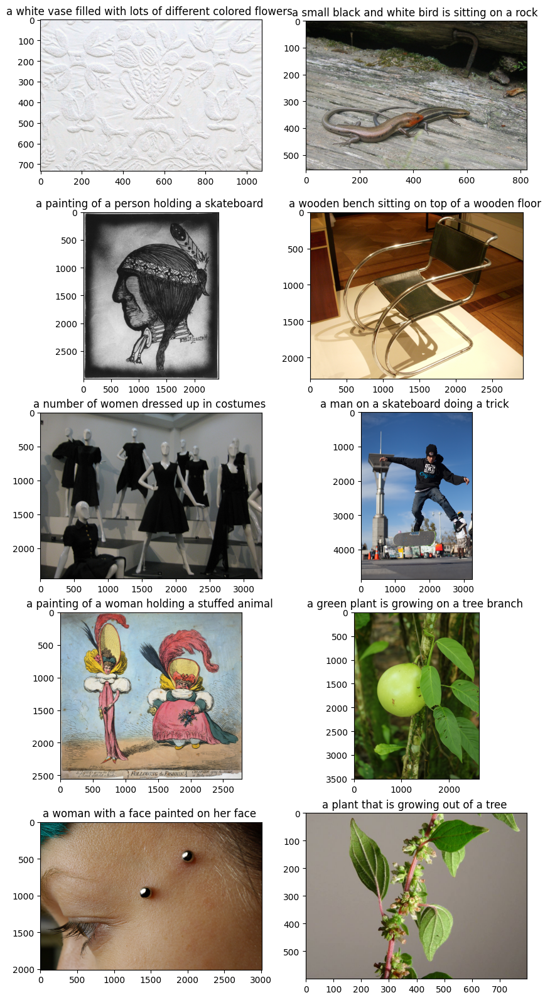

In [162]:
test_data = df.iloc[12868]
generated_text_list = []


fig, axes = plt.subplots(nrows = 5, ncols = 2, figsize = (10,20))

for img in range(1,11):
    selected_col = test_data[f'img{img}']
    IMAGE_PATH = "/Users/carlosito/Documents/vsCode/vs-DANI/DL-Project/semeval-2023-task-1-V-WSD-train-v1/train_v1/train_images_v1/"
    IMAGE_PATH_EACH = IMAGE_PATH + selected_col
    
    plot_img = Image.open(IMAGE_PATH_EACH)
    if plot_img.mode != "RGB":          #add this thing
      plot_img = plot_img.convert(mode="RGB")
    
    axes.flatten()[img-1].imshow(plot_img)
    
    
    pixel_values = feature_extractor(images= plot_img, return_tensors="pt").pixel_values
    pixel_values = pixel_values.to(device)
    gen_kwargs = {"max_length": max_length, "num_beams": num_beams}
    output_ids = model.generate(pixel_values, **gen_kwargs)
    pred = tokenizer.batch_decode(output_ids, skip_special_tokens=True)
    axes.flatten()[img-1].title.set_text(pred[0])

    generated_text_list.extend(pred)

In [163]:
word_description = lesk(word_tokenize(test_data['context']), test_data['keyword']).definition()
print(word_description)
rouge_score_list = []
for i in range(10):
    rouge_score = rouge.get_scores(word_description, generated_text_list[i] )[0]['rouge-1']['f']
    print(rouge_score)
    rouge_score_list.append(rouge_score)
    
print()
predicted_image_idx = np.argmax(rouge_score_list)
print(predicted_image_idx)

print(f"predicted img: {test_data[f'img{predicted_image_idx+1}']}")
print(f"true img: {test_data.gold_key}")

a band worn around or over the head
0.11111110617283973
0.11111110617283973
0.14285713795918387
0.1249999950000002
0.1249999950000002
0.14285713795918387
0.13333332835555575
0.1249999950000002
0.13333332835555575
0.1249999950000002

2
predicted img: image.8747.jpg
true img: image.8747.jpg


In [166]:
word_description = lesk(word_tokenize(test_data['context']), 'band').definition()
print(word_description)
rouge_score_list = []
for i in range(10):
    rouge_score = rouge.get_scores(word_description, generated_text_list[i] )[0]['rouge-1']['f']
    print(rouge_score)
    rouge_score_list.append(rouge_score)
    
print()
predicted_image_idx = np.argmax(rouge_score_list)
print(predicted_image_idx)

print(f"predicted img: {test_data[f'img{predicted_image_idx+1}']}")
print(f"true img: {test_data.gold_key}")

bind or tie together, as with a band
0.22222221728395072
0.11111110617283973
0.14285713795918387
0.1249999950000002
0.1249999950000002
0.14285713795918387
0.13333332835555575
0.1249999950000002
0.266666661688889
0.1249999950000002

8
predicted img: image.342.jpg
true img: image.8747.jpg


---

## Model cannot predict any word

In [168]:
df.iloc[1616]

keyword                post-horn
context     post-horn aerophonic
img1              image.4656.jpg
img2              image.4469.jpg
img3             image.12132.jpg
img4              image.4468.jpg
img5              image.3256.jpg
img6               image.637.jpg
img7             image.12133.jpg
img8              image.4472.jpg
img9              image.4470.jpg
img10             image.4471.jpg
gold_key         image.12132.jpg
Name: 1616, dtype: object

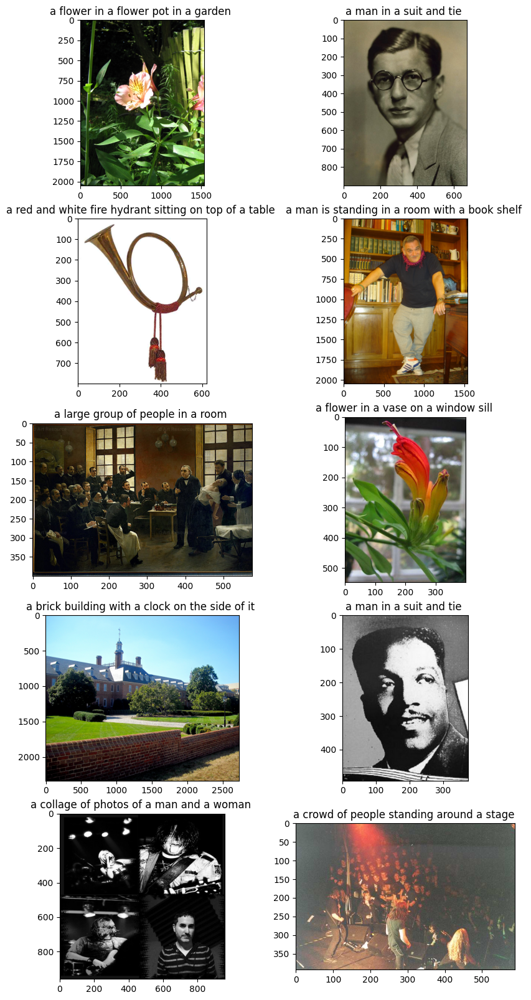

In [169]:
test_data = df.iloc[1616]
generated_text_list = []


fig, axes = plt.subplots(nrows = 5, ncols = 2, figsize = (10,20))

for img in range(1,11):
    selected_col = test_data[f'img{img}']
    IMAGE_PATH = "/Users/carlosito/Documents/vsCode/vs-DANI/DL-Project/semeval-2023-task-1-V-WSD-train-v1/train_v1/train_images_v1/"
    IMAGE_PATH_EACH = IMAGE_PATH + selected_col
    
    plot_img = Image.open(IMAGE_PATH_EACH)
    if plot_img.mode != "RGB":          #add this thing
      plot_img = plot_img.convert(mode="RGB")
    
    axes.flatten()[img-1].imshow(plot_img)
    
    
    pixel_values = feature_extractor(images= plot_img, return_tensors="pt").pixel_values
    pixel_values = pixel_values.to(device)
    gen_kwargs = {"max_length": max_length, "num_beams": num_beams}
    output_ids = model.generate(pixel_values, **gen_kwargs)
    pred = tokenizer.batch_decode(output_ids, skip_special_tokens=True)
    axes.flatten()[img-1].title.set_text(pred[0])

    generated_text_list.extend(pred)

In [171]:
lesk(word_tokenize(test_data['context']), test_data['keyword'])

In [172]:
word_tokenize(test_data['context'])

['post-horn', 'aerophonic']

In [175]:
lesk(word_tokenize(test_data['context']), 'horn').definition()

'stab or pierce with a horn or tusk'